AI for Medical Sciences and Psychology by Tshepo Chris Nokeri, Apress. 2022

# Chapter 4 CCancer Segmentation with Neural Networks

This chapter typically exhibits the practical application of computer vision and convolutional neural networks for breast and skin cancer realization and segmentation. Equally, it shows an approach to filter medical scans by applying canny, luplican, and sobel filters. It concludes by ascertaining the extent to which the networks accurately differentiate scans of patients with and without cancer.

# Classifying Patients’ Cardiovascular Disease Diagnosis Outcome Data by Executing a Deep Belief Network

Using TensorFlow backend.


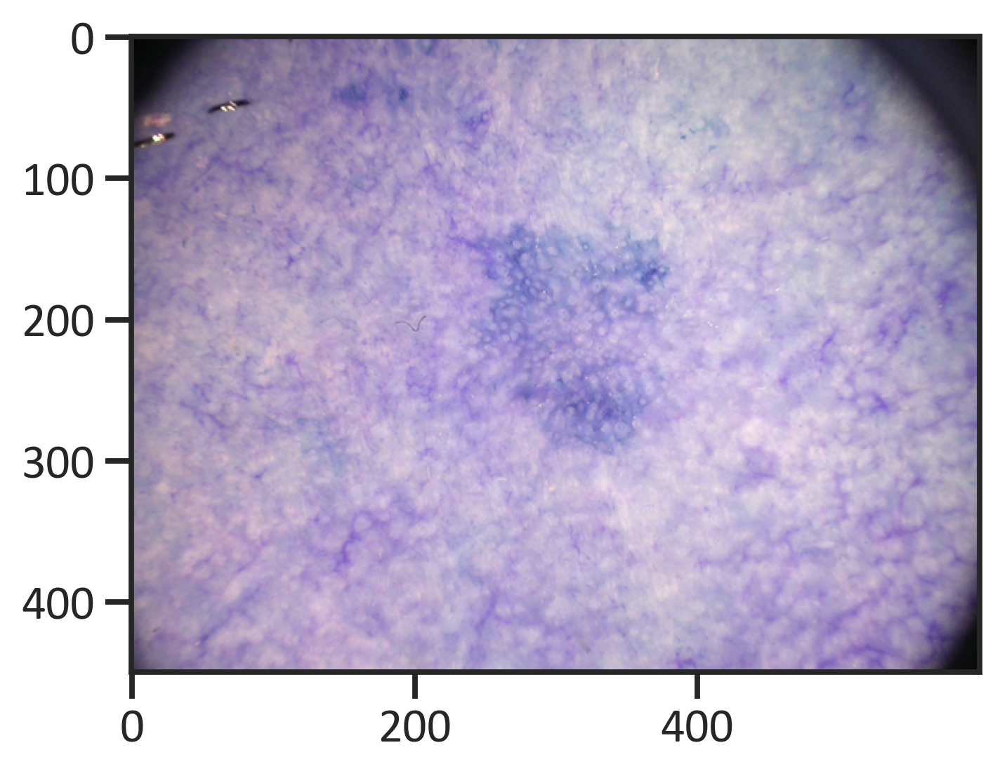

In [1]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set("talk","ticks", font_scale = 1, font = "Calibri")
from pylab import rcParams
plt.rcParams["figure.dpi"] = 300
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras import Sequential, regularizers
from tensorflow.keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.metrics import classification_report
import cv2
import shutil
import glob
import os
skin_cancer_actinic_keratosis_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_actinic_keratosis_categories = ["actinic keratosis"]
for x in skin_cancer_actinic_keratosis_categories:
    directory = os.path.join(skin_cancer_actinic_keratosis_data, x)
    for skin_cancer_actinic_keratosis_image in os.listdir(directory):
        skin_cancer_actinic_keratosis_images = cv2.imread(os.path.join(directory, skin_cancer_actinic_keratosis_image))   
plt.imshow(skin_cancer_actinic_keratosis_images)
plt.show()

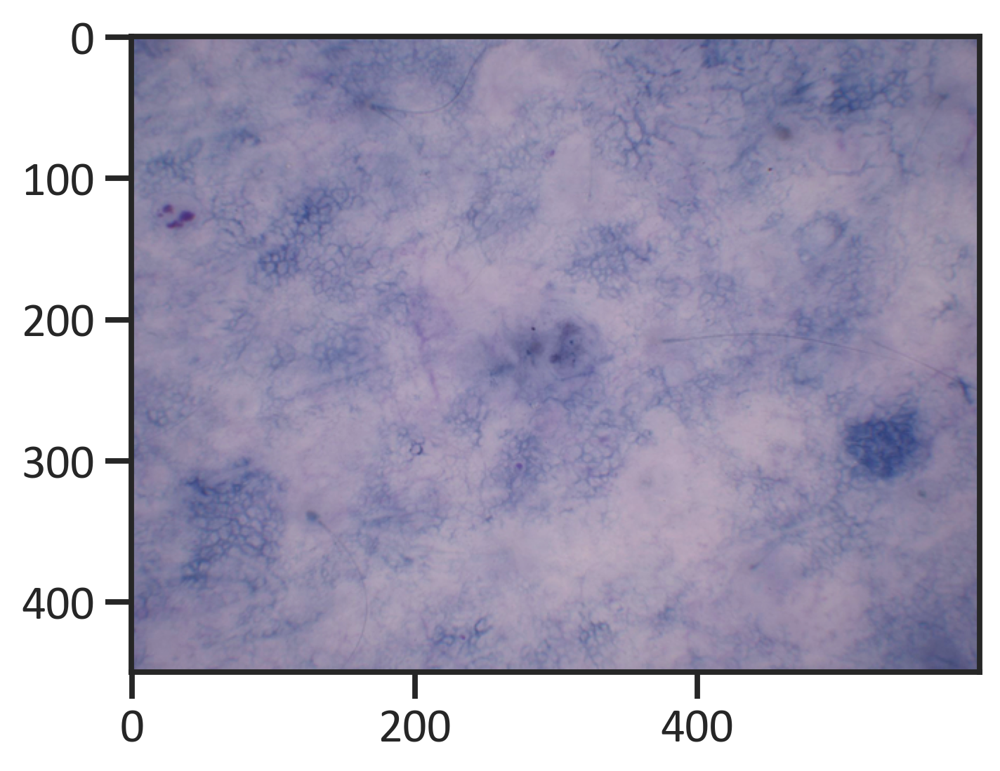

In [2]:
skin_cancer_basal_cell_carcinoma_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_basal_cell_carcinoma_categories = ["basal cell carcinoma"]
for x in skin_cancer_basal_cell_carcinoma_categories:
    directory = os.path.join(skin_cancer_basal_cell_carcinoma_data, x)
    for skin_cancer_basal_cell_carcinoma_image in os.listdir(directory):
        skin_cancer_basal_cell_carcinoma_images = cv2.imread(os.path.join(directory, skin_cancer_basal_cell_carcinoma_image))   
plt.imshow(skin_cancer_basal_cell_carcinoma_images)
plt.show()

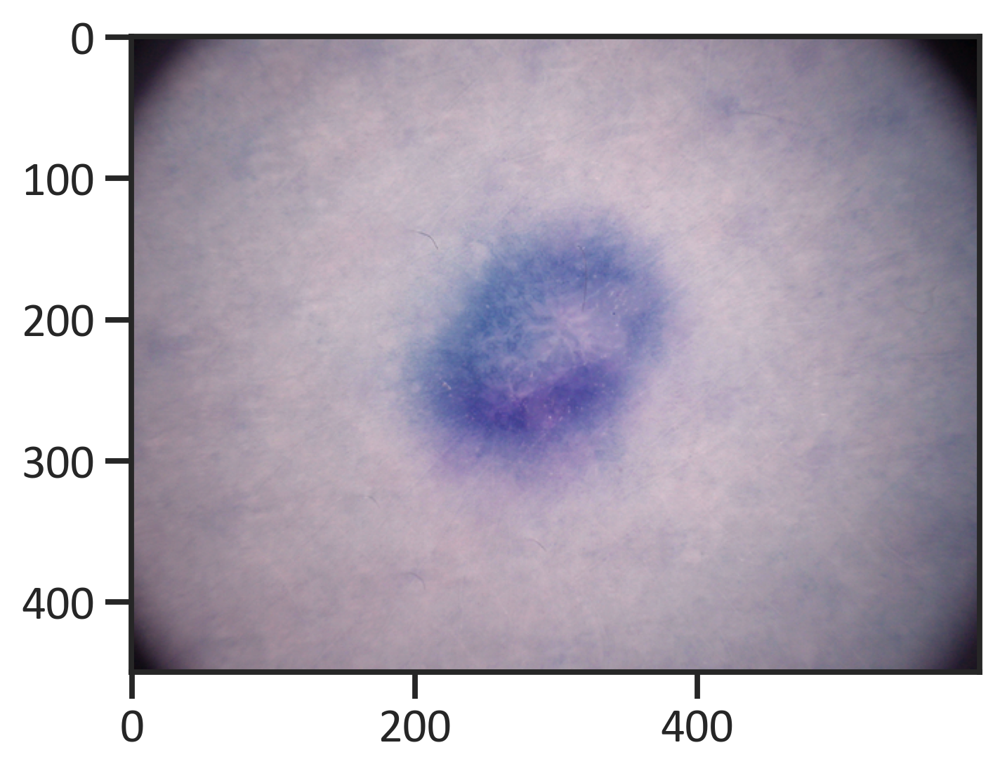

In [3]:
skin_cancer_dermatofibroma_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_dermatofibroma_categories = ["dermatofibroma"]
for x in skin_cancer_dermatofibroma_categories:
    directory = os.path.join(skin_cancer_dermatofibroma_data, x)
    for skin_cancer_dermatofibroma_image in os.listdir(directory):
        skin_cancer_dermatofibroma_images = cv2.imread(os.path.join(directory, skin_cancer_dermatofibroma_image))   
plt.imshow(skin_cancer_dermatofibroma_images)
plt.show()

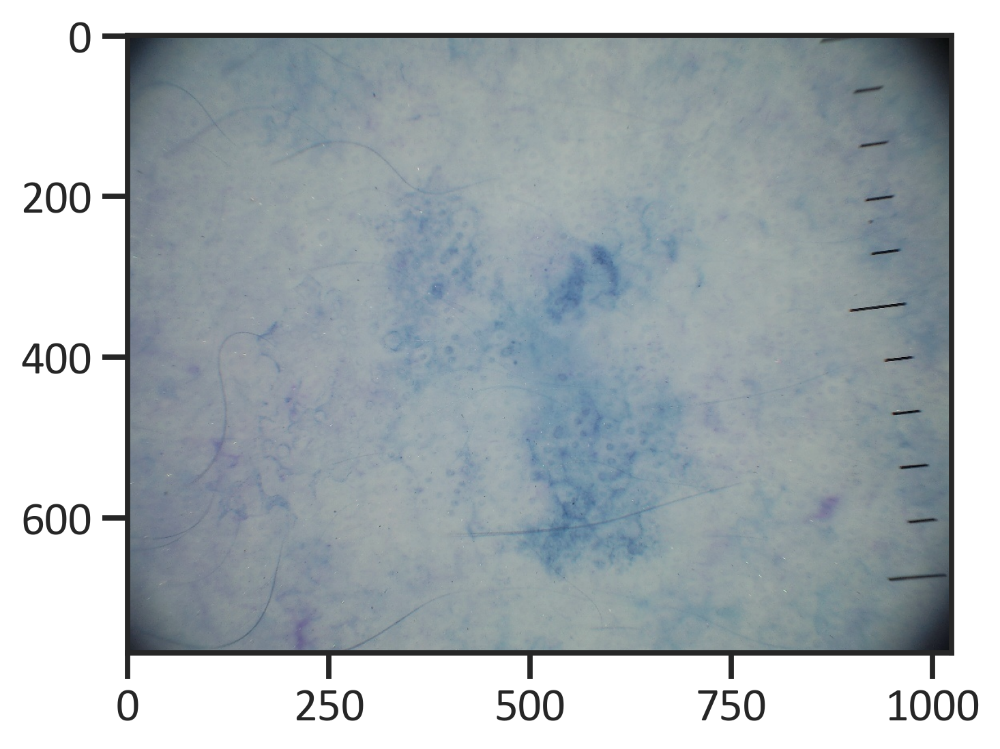

In [4]:
skin_cancer_melanoma_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_melanoma_categories = ["melanoma"]
for x in skin_cancer_melanoma_categories:
    directory = os.path.join(skin_cancer_melanoma_data, x)
    for skin_cancer_melanoma_image in os.listdir(directory):
        skin_cancer_melanoma_images = cv2.imread(os.path.join(directory, skin_cancer_melanoma_image))   
plt.imshow(skin_cancer_melanoma_images)
plt.show()


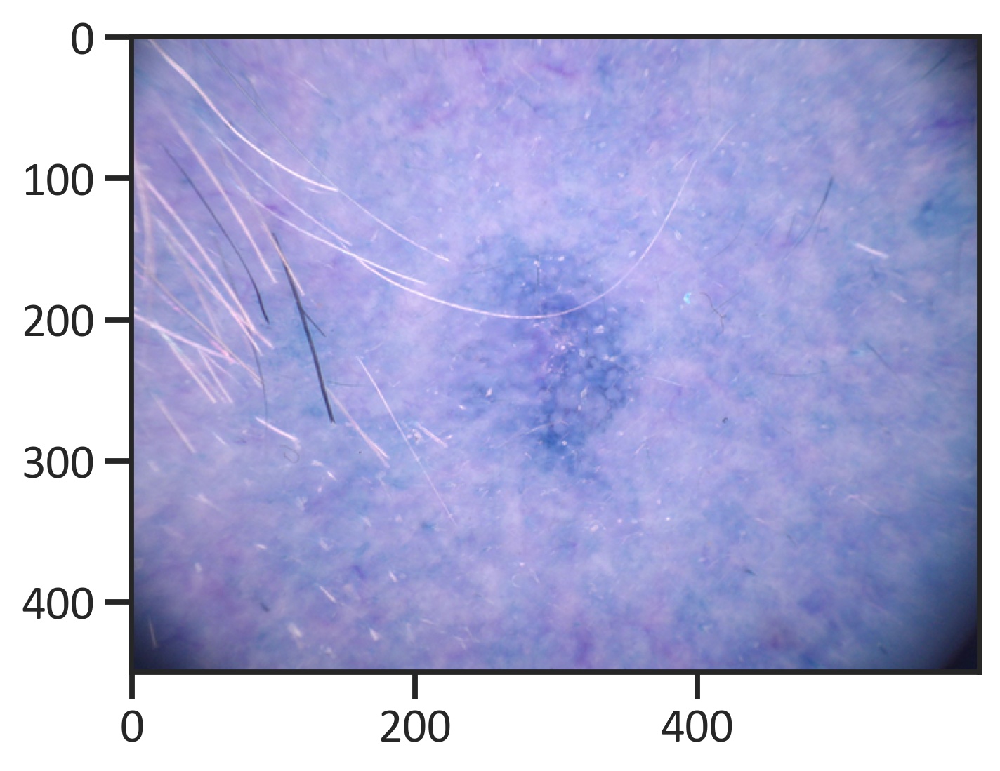

In [5]:
skin_cancer_nevus_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_nevus_categories = ["nevus"]
for x in skin_cancer_nevus_categories:
    directory = os.path.join(skin_cancer_nevus_data, x)
    for skin_cancer_nevus_image in os.listdir(directory):
        skin_cancer_nevus_images = cv2.imread(os.path.join(directory, skin_cancer_nevus_image))   
plt.imshow(skin_cancer_nevus_images)
plt.show()


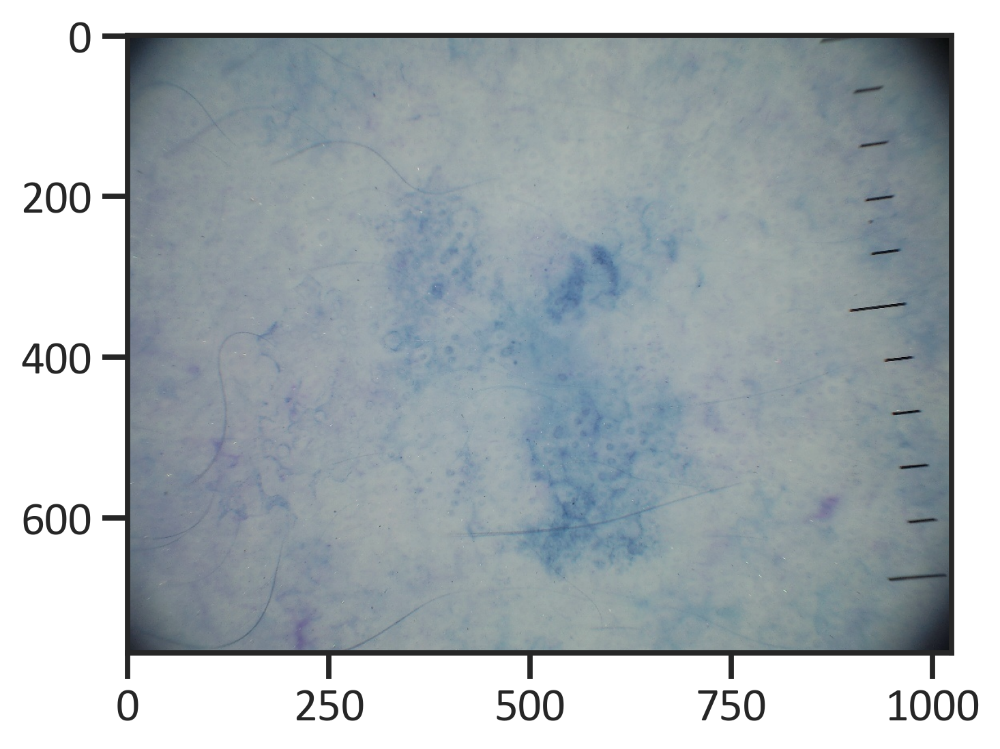

In [6]:
skin_cancer_seborrheic_keratosis_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_seborrheic_keratosis_categories = ["seborrheic keratosis"]
for x in skin_cancer_seborrheic_keratosis_categories:
    directory = os.path.join(skin_cancer_seborrheic_keratosis_data, x)
    for skin_cancer_seborrheic_keratosis_image in os.listdir(directory):
        skin_cancer_seborrheic_keratosis_images = cv2.imread(os.path.join(directory, skin_cancer_seborrheic_keratosis_image))   
plt.imshow(skin_cancer_seborrheic_keratosis_images)
plt.show()


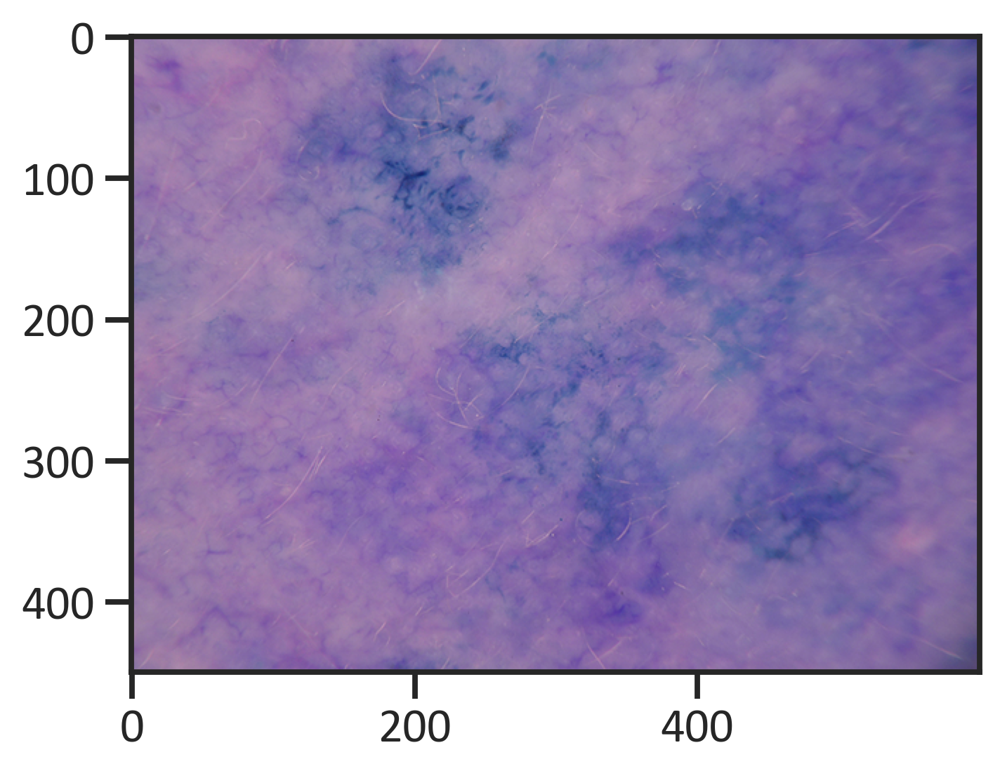

In [7]:
skin_cancer_pigmented_benign_keratosis_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_pigmented_benign_keratosis_categories = ["pigmented benign keratosis"]
for x in skin_cancer_pigmented_benign_keratosis_categories:
    directory = os.path.join(skin_cancer_pigmented_benign_keratosis_data, x)
    for skin_cancer_pigmented_benign_keratosis_image in os.listdir(directory):
        skin_cancer_pigmented_benign_keratosis_images = cv2.imread(os.path.join(directory, skin_cancer_pigmented_benign_keratosis_image))   
plt.imshow(skin_cancer_pigmented_benign_keratosis_images)
plt.show()

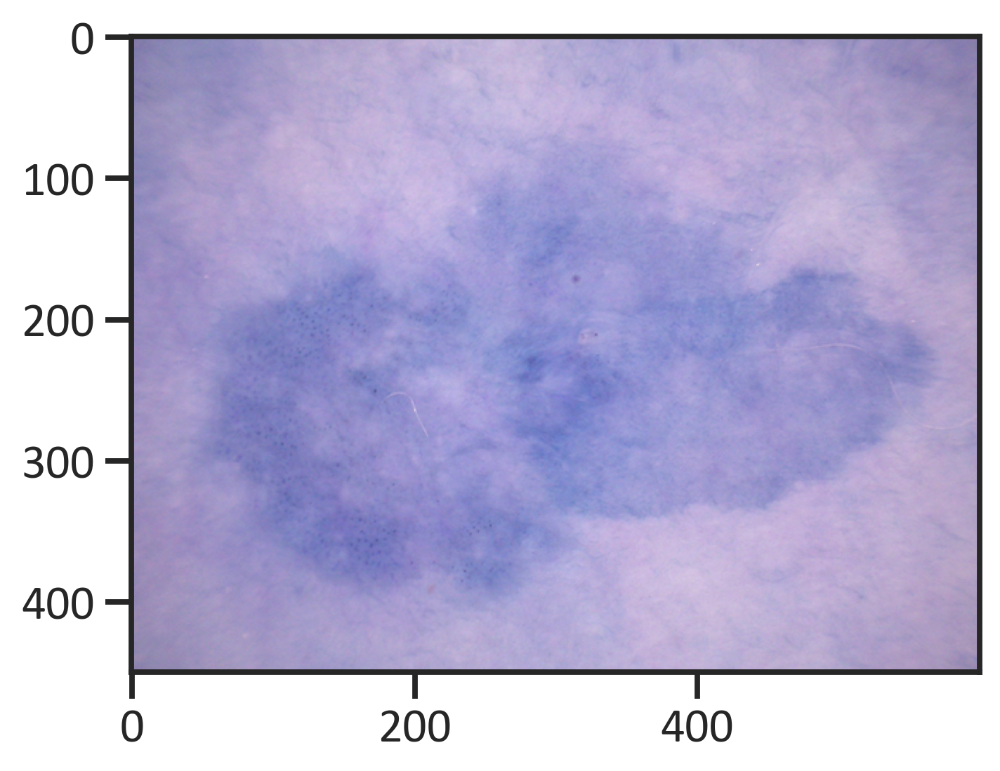

In [8]:
skin_cancer_squamous_cell_carcinoma_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_squamous_cell_carcinoma_categories = ["squamous cell carcinoma"]
for x in skin_cancer_squamous_cell_carcinoma_categories:
    directory = os.path.join(skin_cancer_squamous_cell_carcinoma_data, x)
    for skin_cancer_squamous_cell_carcinoma_image in os.listdir(directory):
        skin_cancer_squamous_cell_carcinoma_images = cv2.imread(os.path.join(directory, skin_cancer_squamous_cell_carcinoma_image))   
plt.imshow(skin_cancer_squamous_cell_carcinoma_images)
plt.show()


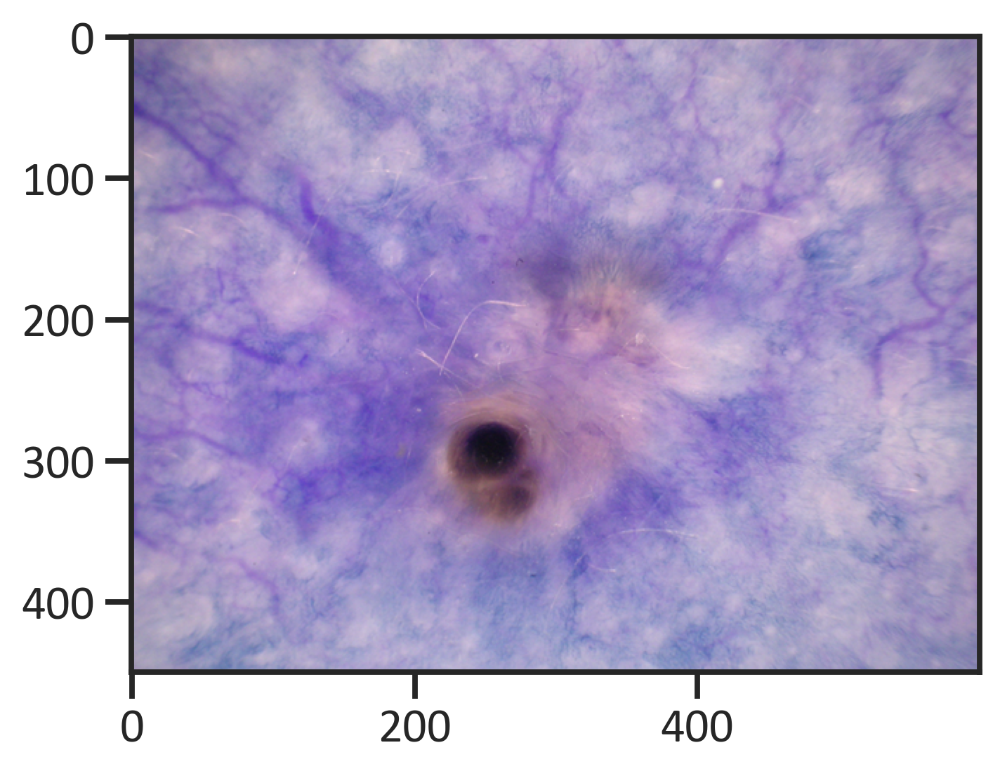

In [9]:
skin_cancer_vascular_lesion_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train"
skin_cancer_vascular_lesion_categories = ["vascular lesion"]
for x in skin_cancer_vascular_lesion_categories:
    directory = os.path.join(skin_cancer_vascular_lesion_data, x)
    for skin_cancer_vascular_lesion_image in os.listdir(directory):
        skin_cancer_vascular_lesion_images = cv2.imread(os.path.join(directory, skin_cancer_vascular_lesion_image))   
plt.imshow(skin_cancer_vascular_lesion_images)
plt.show()


In [10]:
import pathlib
skin_cancer_data = pathlib.Path(r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\skin_cancer\Train")

In [11]:
skin_cancer_training_data = tf.keras.preprocessing.image_dataset_from_directory(skin_cancer_data, seed = 123, validation_split = 0.2, subset = "training",  image_size = (180, 180), batch_size = 16)

Found 2239 files belonging to 9 classes.
Using 1792 files for training.


In [12]:
skin_cancer_validation_data = tf.keras.preprocessing.image_dataset_from_directory(skin_cancer_data, seed = 123, validation_split = 0.2, subset = "validation", image_size = (180, 180), batch_size = 16)

Found 2239 files belonging to 9 classes.
Using 447 files for validation.


Found 2239 images belonging to 9 classes.


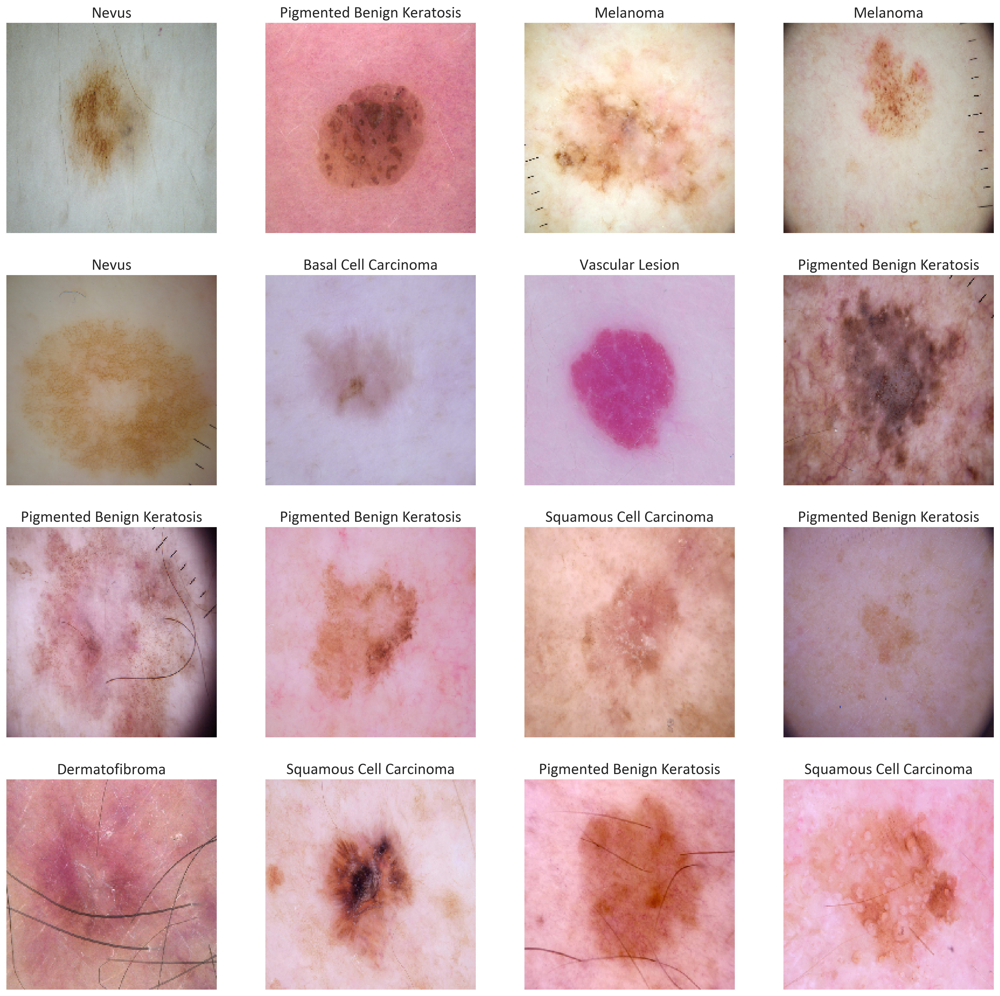

In [13]:
import keras
skin_cancer_training_data_categories = np.array(skin_cancer_training_data.class_names)
skin_cancer_training_data_categories = np.array(skin_cancer_training_data.class_names)
skin_cancer_generated_image_data = keras.preprocessing.image.ImageDataGenerator(rescale = 1./255)
skin_cancer_generated_image_data_for_training = skin_cancer_generated_image_data.flow_from_directory(skin_cancer_data, 
                                                                                                     target_size = (180, 180), 
                                                                                                     class_mode = "categorical", 
                                                                                                     shuffle = True, 
                                                                                                     batch_size = 16)
skin_cancer_images, skin_cancer_labels = next(iter(skin_cancer_generated_image_data_for_training))
def skin_cancer_images_function(skin_cancer_images, skin_cancer_labels):
    plt.figure(figsize = (20, 20))
    for n in range(16):
        ax = plt.subplot(4, 4, n+1)
        plt.imshow(skin_cancer_images[n])
        plt.title(skin_cancer_training_data_categories[skin_cancer_labels[n]==1][0].title())
        plt.axis("off")
skin_cancer_images_function(skin_cancer_images, skin_cancer_labels)

In [14]:
skin_cancer_experimental_tuning = tf.data.experimental.AUTOTUNE
skin_cancer_training_data = skin_cancer_training_data.cache().shuffle(1000).prefetch(buffer_size = skin_cancer_experimental_tuning)
skin_cancer_validation_data = skin_cancer_validation_data.cache().prefetch(buffer_size = skin_cancer_experimental_tuning)


In [15]:
from tensorflow.keras import layers
from tensorflow.python.keras.layers import Dense, Flatten, Conv2D, Dropout, MaxPooling2D
skin_cancer_convolutional_net_model = Sequential([
    layers.experimental.preprocessing.Rescaling(1./255, input_shape = (180, 180, 3)),
    layers.Conv2D(16, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Conv2D(32, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Conv2D(64, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers.Dense(128, activation = "relu"),
    layers.Dense(9, activation='softmax')])
skin_cancer_convolutional_net_model.compile(optimizer = "adam",
                                loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True),
                                metrics = ["accuracy"])
skin_cancer_convolutional_net_model_history = skin_cancer_convolutional_net_model.fit(skin_cancer_training_data,
                                                              validation_data = skin_cancer_validation_data,
                                                              epochs = 64)
skin_cancer_convolutional_net_model_history


Epoch 1/64
112/112 [==============================] - 70s 627ms/step - loss: 2.1210 - accuracy: 0.2143 - val_loss: 2.0705 - val_accuracy: 0.2819
Epoch 2/64
112/112 [==============================] - 59s 527ms/step - loss: 2.0373 - accuracy: 0.3292 - val_loss: 2.0703 - val_accuracy: 0.3020
Epoch 3/64
112/112 [==============================] - 56s 504ms/step - loss: 2.0859 - accuracy: 0.2751 - val_loss: 2.0479 - val_accuracy: 0.3154
Epoch 4/64
112/112 [==============================] - 57s 508ms/step - loss: 2.0420 - accuracy: 0.3259 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 5/64
112/112 [==============================] - 55s 495ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 6/64
112/112 [==============================] - 55s 490ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 7/64
112/112 [==============================] - 54s 481ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_ac

112/112 [==============================] - 54s 483ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 58/64
112/112 [==============================] - 49s 436ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 59/64
112/112 [==============================] - 49s 441ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 60/64
112/112 [==============================] - 49s 442ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 61/64
112/112 [==============================] - 49s 437ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 62/64
112/112 [==============================] - 49s 437ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accuracy: 0.1924
Epoch 63/64
112/112 [==============================] - 50s 443ms/step - loss: 2.1755 - accuracy: 0.1964 - val_loss: 2.1796 - val_accurac

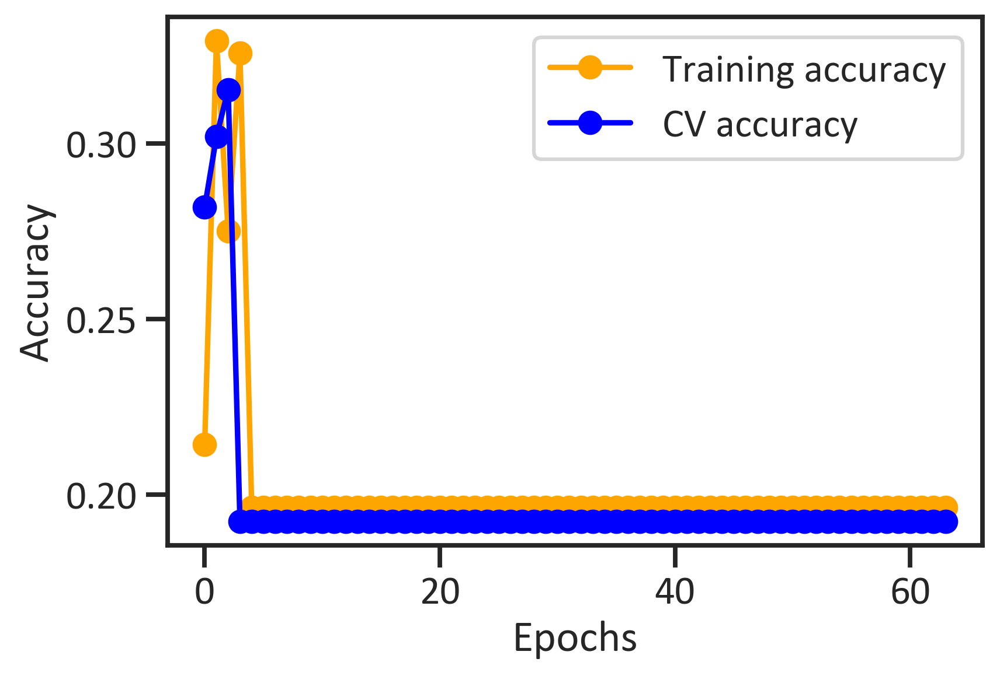

In [16]:
plt.plot(skin_cancer_convolutional_net_model_history.history["accuracy"],
         color = "orange",
         marker = "o",
         label = "Training accuracy")
plt.plot(skin_cancer_convolutional_net_model_history.history["val_accuracy"],
         color = "blue",
         marker = "o",
         label = "CV accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(loc = "best")
plt.show()


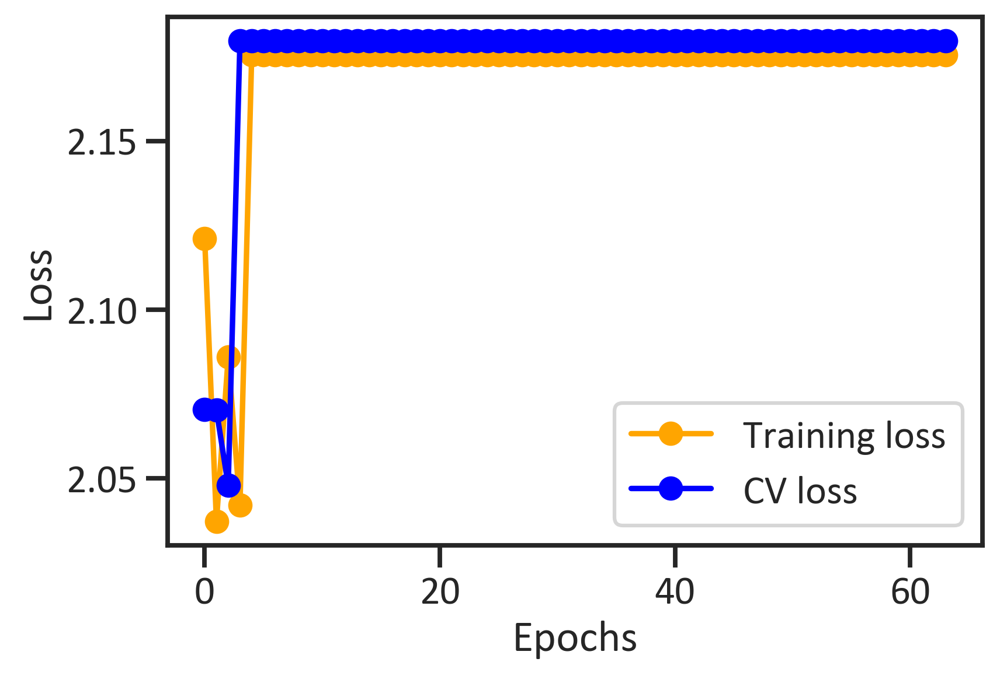

In [17]:
plt.plot(skin_cancer_convolutional_net_model_history.history["loss"],
         color = "orange",
         marker = "o",
         label = "Training loss")
plt.plot(skin_cancer_convolutional_net_model_history.history["val_loss"],
         color = "blue",
         marker = "o",
         label = "CV loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(loc = "best")
plt.show()


## Debunking Breast Cancer

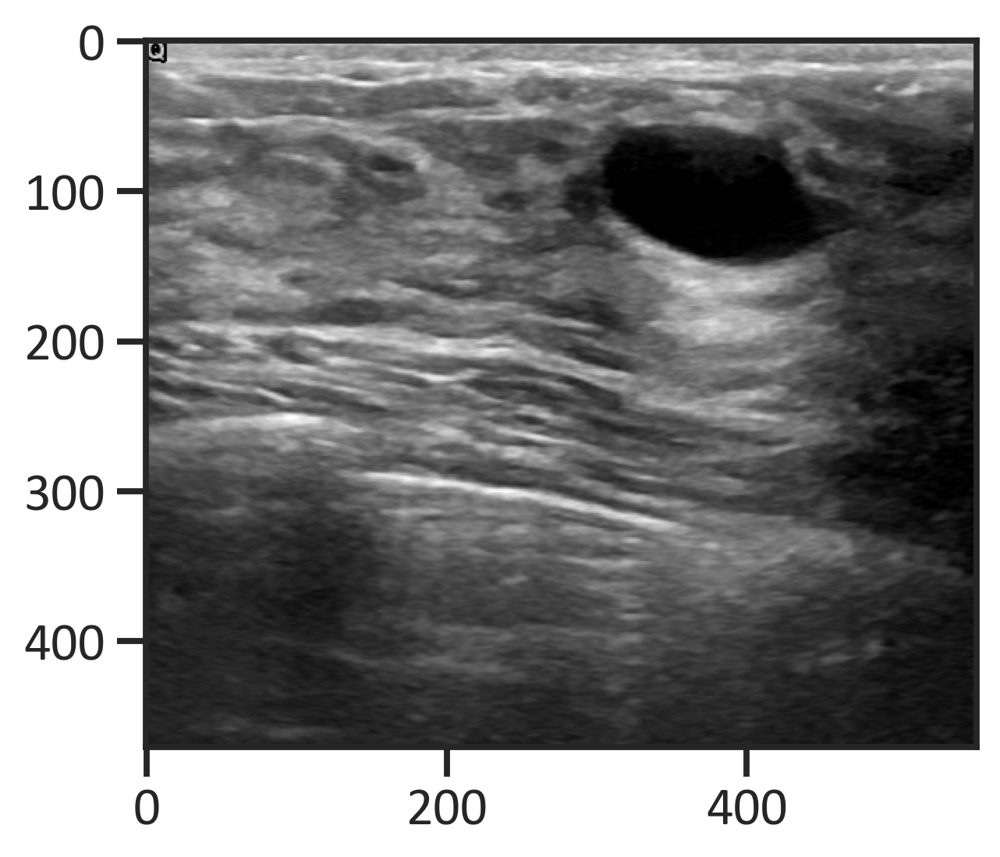

In [18]:
breast_cancer_benign_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\Dataset_BUSI_with_GT"
breast_cancer_benign_categories = ["benign"]
for x in breast_cancer_benign_categories:
    directory = os.path.join(breast_cancer_benign_data, x)
    for breast_cancer_benign_image in os.listdir(directory):
        breast_cancer_benign_images = cv2.imread(os.path.join(directory, breast_cancer_benign_image))   
plt.imshow(breast_cancer_benign_images)
plt.show()


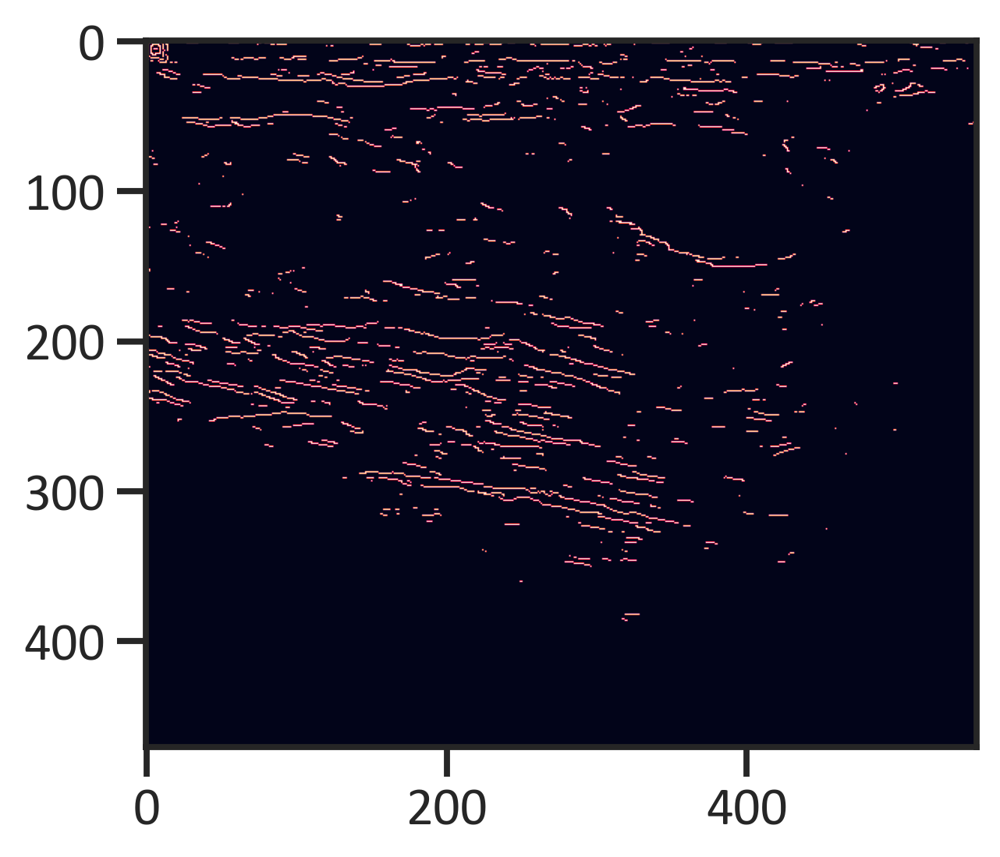

In [19]:
canny_breast_cancer_benign_images = cv2.Canny(breast_cancer_benign_images, 180, 180)
plt.imshow(canny_breast_cancer_benign_images)
plt.show()

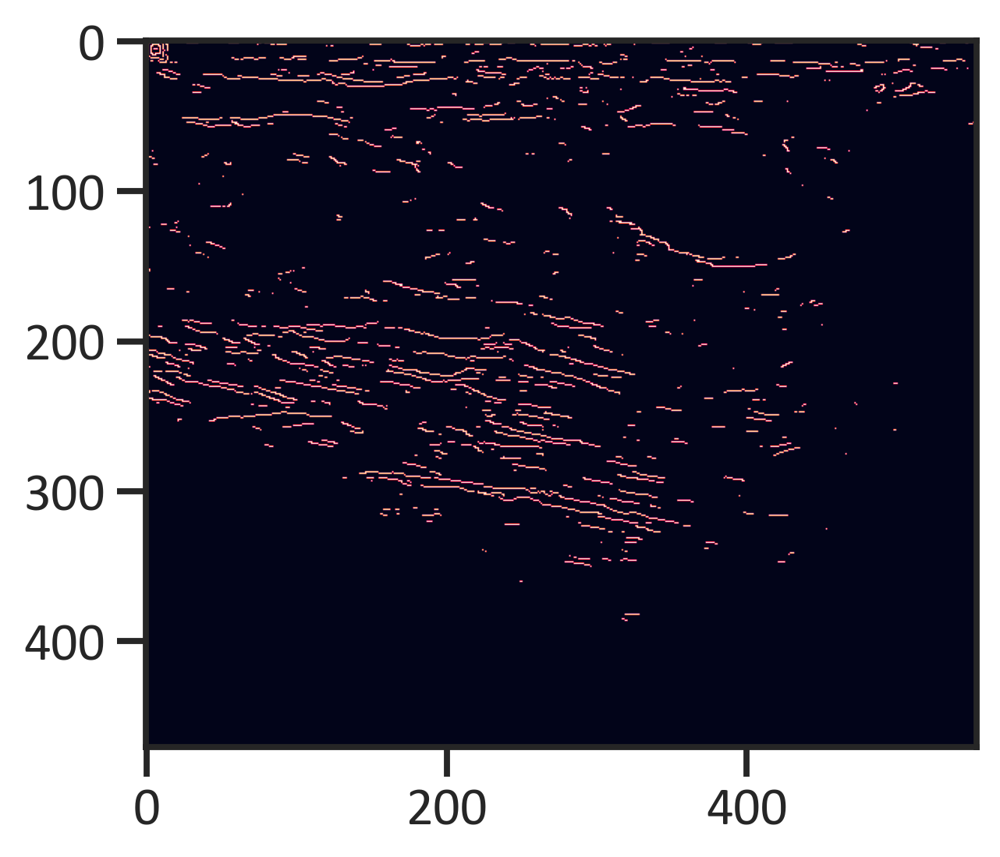

In [20]:
laplacian_breast_cancer_benign_images = cv2.Laplacian(breast_cancer_benign_images, cv2.CV_64F)
plt.imshow(canny_breast_cancer_benign_images)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


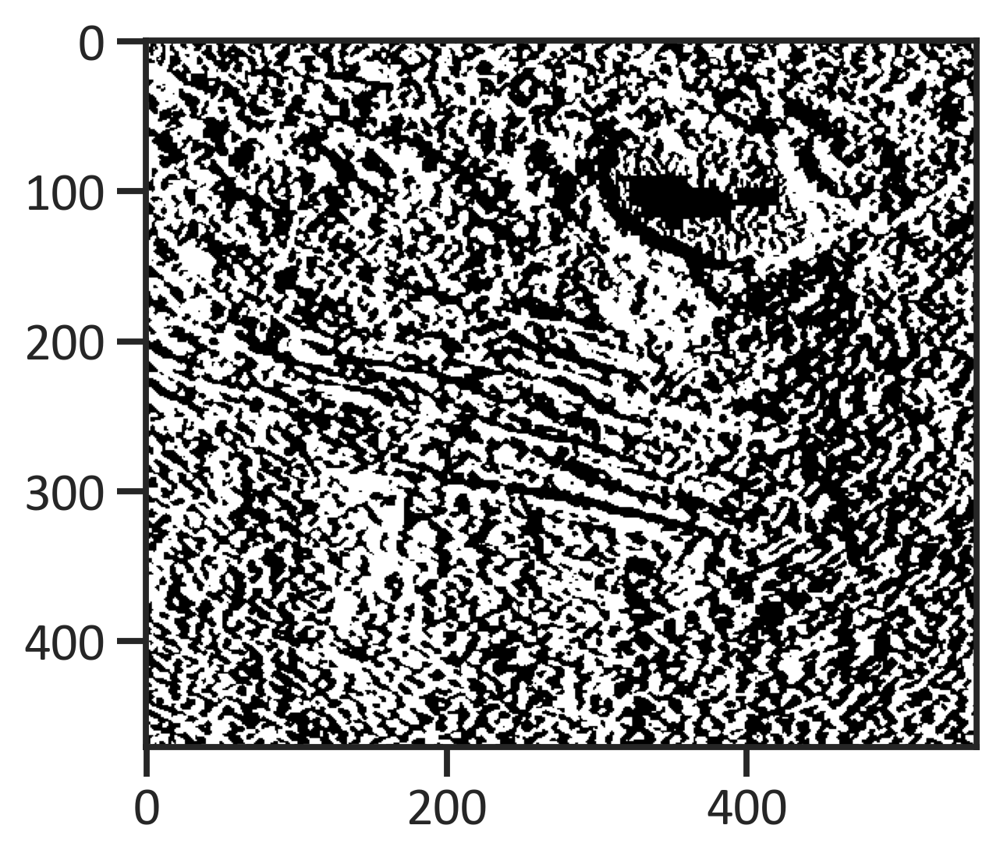

In [21]:
sobel_breast_cancer_benign_images = cv2.Sobel(breast_cancer_benign_images, cv2.CV_64F, 1, 0, ksize=5)
plt.imshow(sobel_breast_cancer_benign_images)
plt.show()


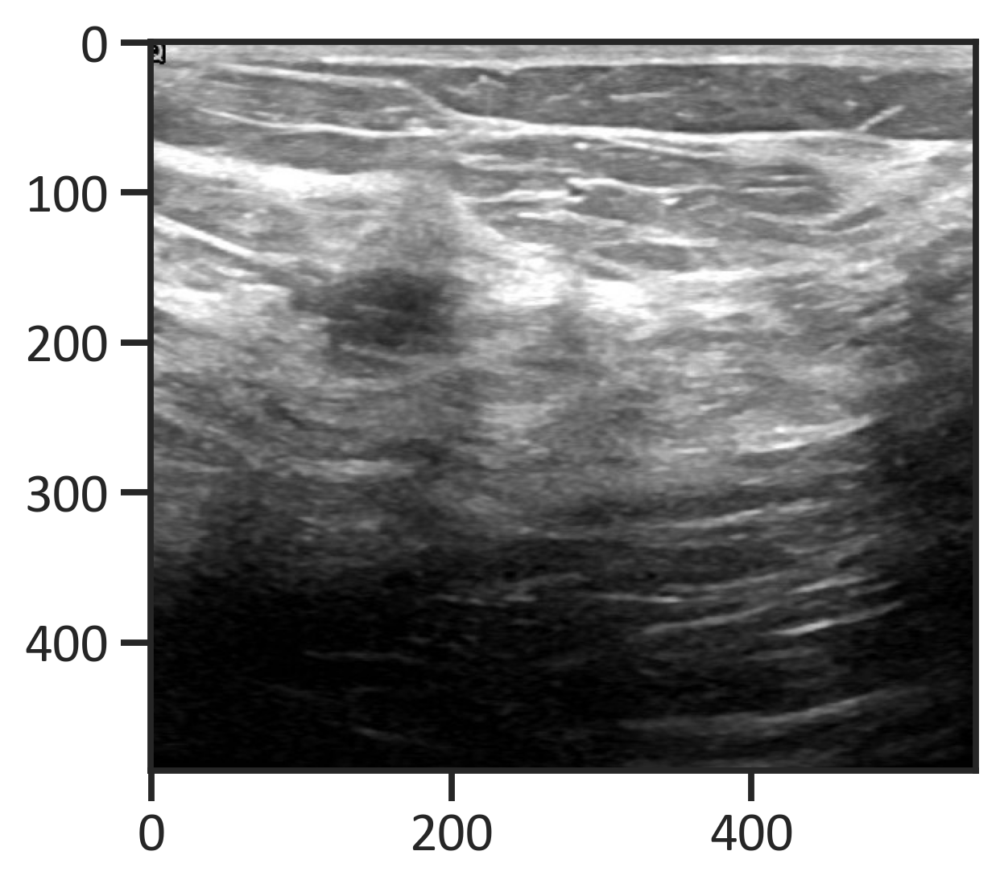

In [22]:
breast_cancer_malignant_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\Dataset_BUSI_with_GT"
breast_cancer_malignant_categories = ["malignant"]
for x in  breast_cancer_malignant_categories:
    directory = os.path.join( breast_cancer_malignant_data, x)
    for  breast_cancer_malignant_image in os.listdir(directory):
         breast_cancer_malignant_images = cv2.imread(os.path.join(directory,  breast_cancer_malignant_image))   
plt.imshow( breast_cancer_malignant_images)
plt.show()


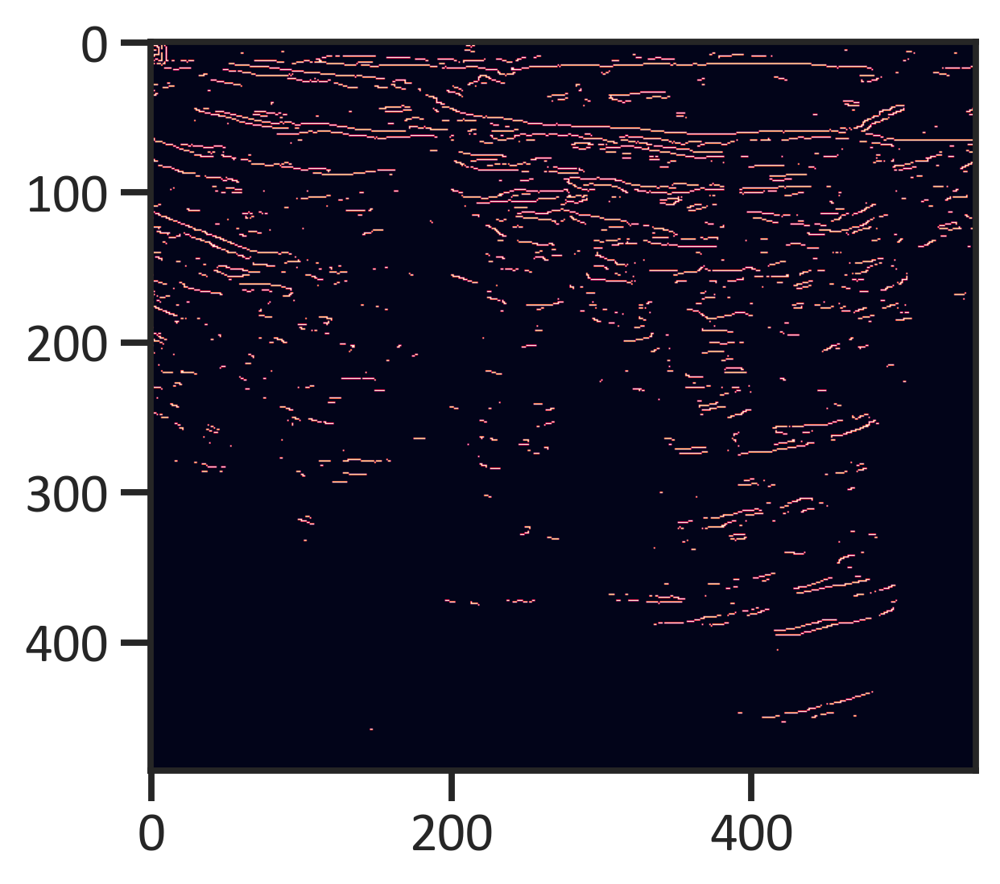

In [23]:
canny_breast_cancer_malignant_images = cv2.Canny(breast_cancer_malignant_images, 180, 180)
plt.imshow(canny_breast_cancer_malignant_images)
plt.show()


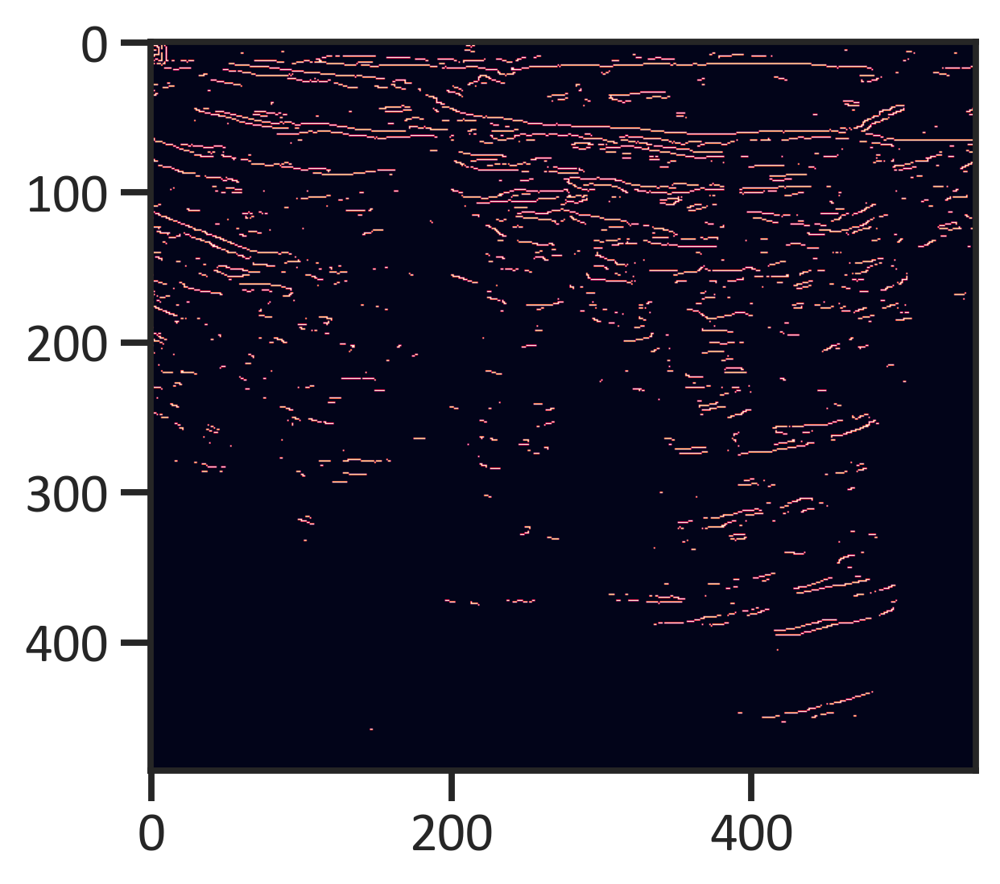

In [24]:
laplacian_breast_cancer_malignant_images = cv2.Laplacian(breast_cancer_malignant_images, cv2.CV_64F)
plt.imshow(canny_breast_cancer_malignant_images)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


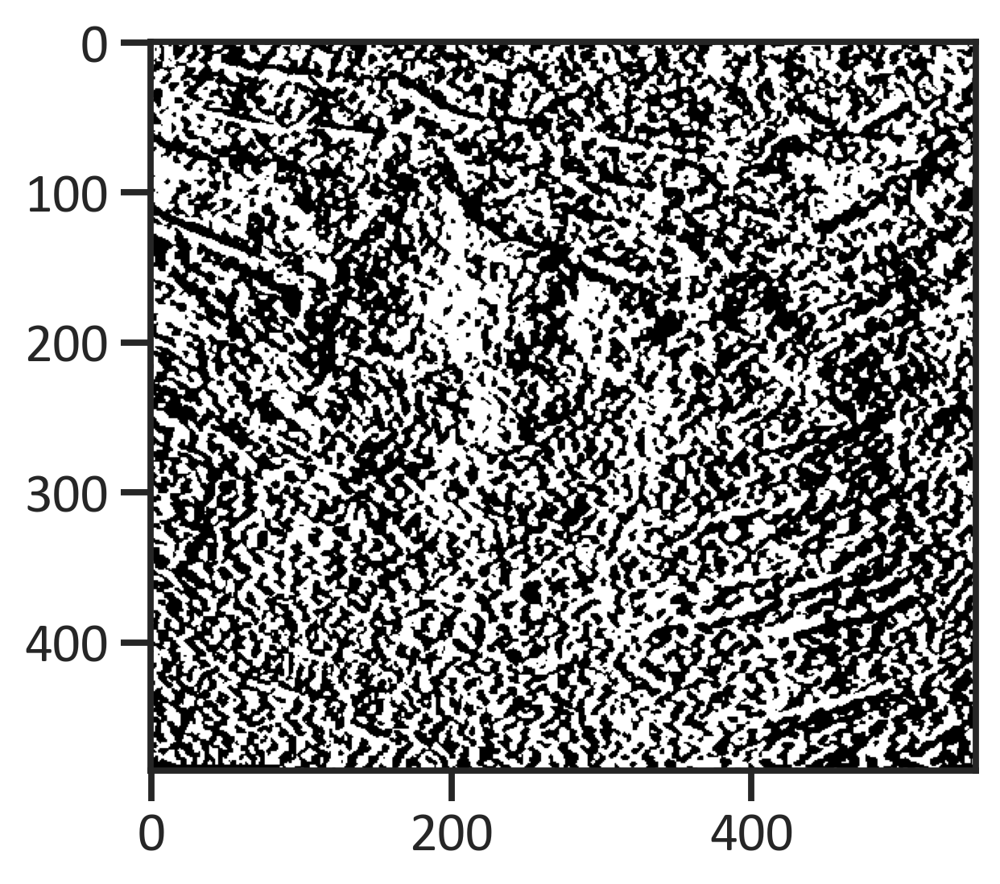

In [25]:
sobel_breast_cancer_malignant_images = cv2.Sobel(breast_cancer_malignant_images, cv2.CV_64F, 1, 0, ksize=5)
plt.imshow(sobel_breast_cancer_malignant_images)
plt.show()


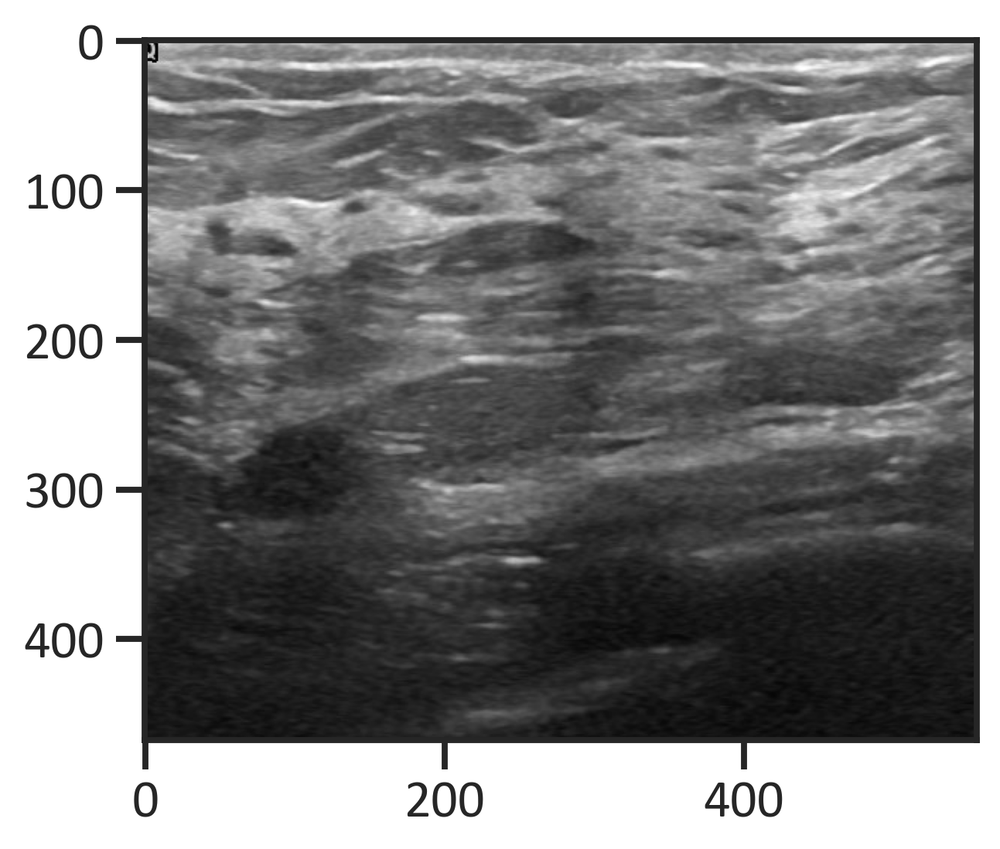

In [26]:
no_breast_cancer_data = r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\Dataset_BUSI_with_GT"
no_breast_cancer_categories = ["normal"]
for x in no_breast_cancer_categories:
    directory = os.path.join(no_breast_cancer_data, x)
    for no_breast_cancer_image in os.listdir(directory):
        no_breast_cancer_images = cv2.imread(os.path.join(directory, no_breast_cancer_image))   
plt.imshow(no_breast_cancer_images)
plt.show()


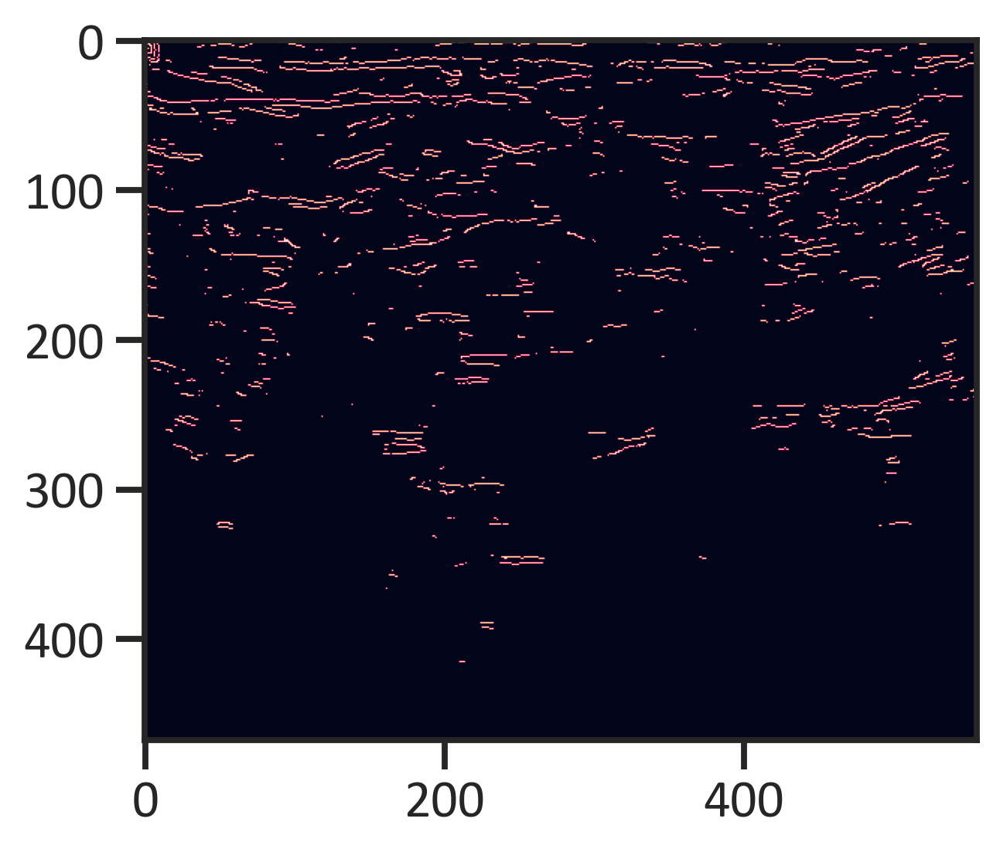

In [27]:
canny_no_breast_cancer_images = cv2.Canny(no_breast_cancer_images, 180, 180)
plt.imshow(canny_no_breast_cancer_images)
plt.show()


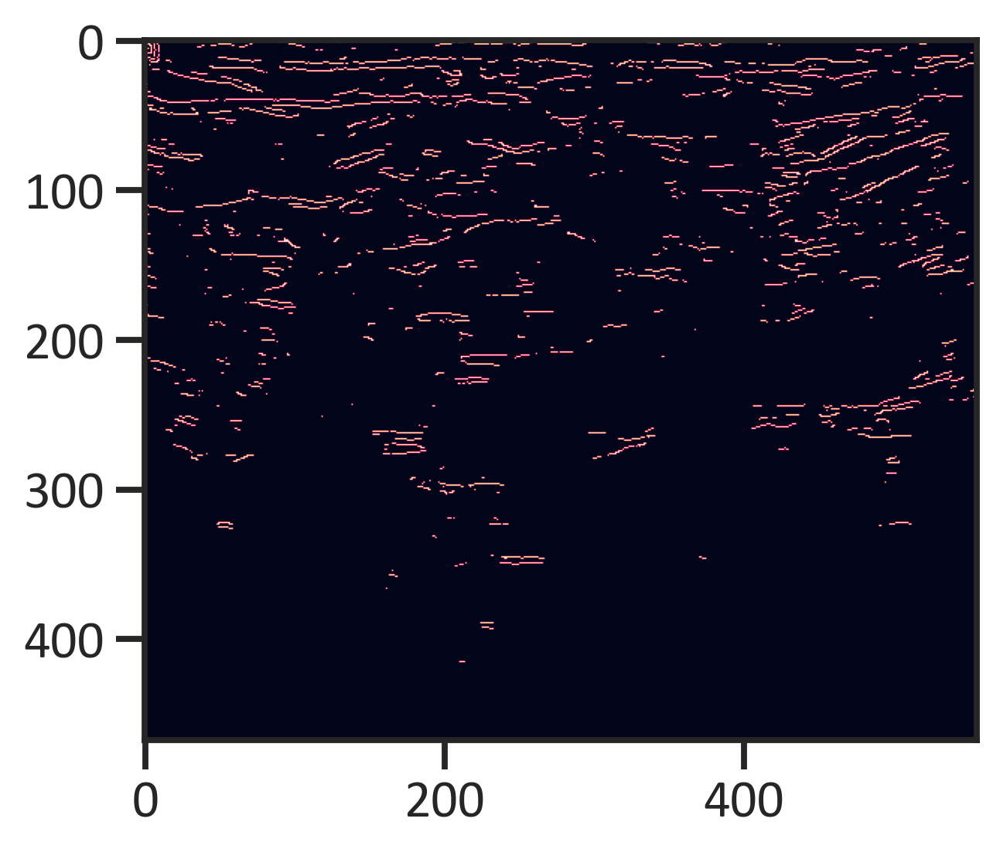

In [28]:
laplacian_no_breast_cancer_images = cv2.Laplacian(no_breast_cancer_images, cv2.CV_64F)
plt.imshow(canny_no_breast_cancer_images)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


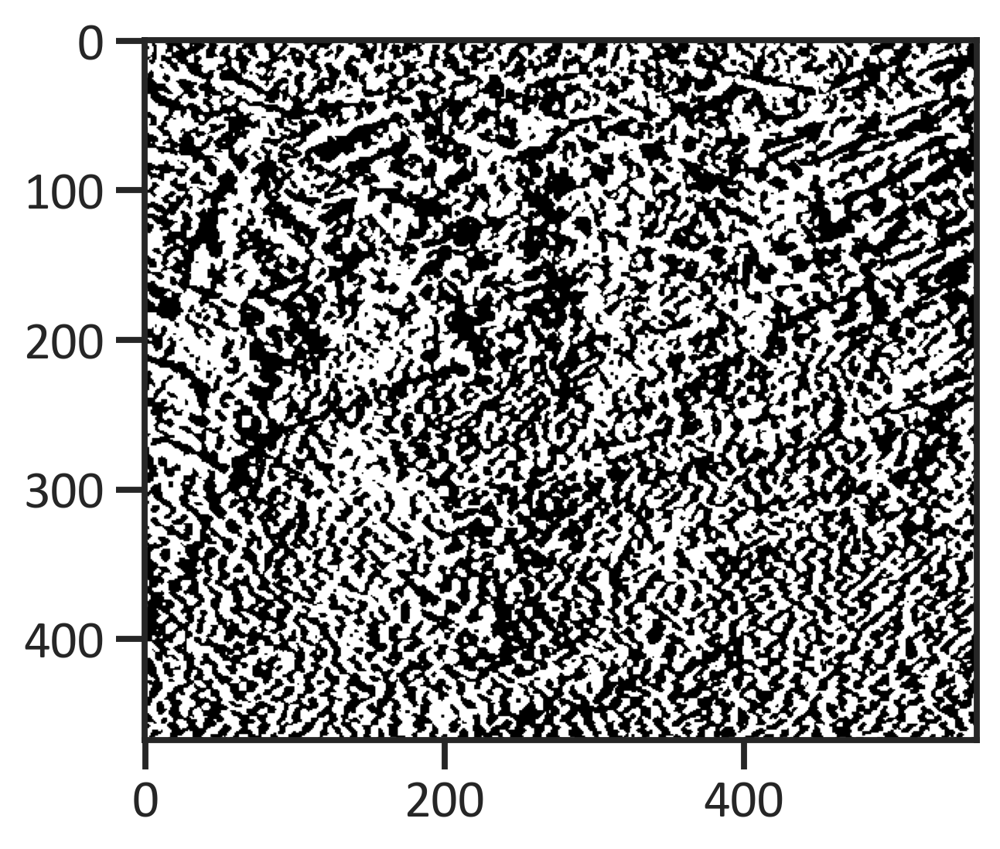

In [29]:
sobel_no_breast_cancer_images = cv2.Sobel(no_breast_cancer_images, cv2.CV_64F, 1, 0, ksize=5)
plt.imshow(sobel_no_breast_cancer_images)
plt.show()


In [30]:
breast_cancer_data = pathlib.Path(r"C:\Users\i5 lenov\Desktop\Next_Chapter\source_code\Dataset_BUSI_with_GT")

In [31]:
breast_cancer_training_data = tf.keras.preprocessing.image_dataset_from_directory(breast_cancer_data, seed = 123, validation_split = 0.2, subset = "training",  image_size = (180, 180), batch_size = 16)

Found 780 files belonging to 3 classes.
Using 624 files for training.


In [32]:
breast_cancer_validation_data = tf.keras.preprocessing.image_dataset_from_directory(breast_cancer_data, seed = 123, validation_split = 0.2, subset = "validation", image_size = (180, 180), batch_size = 16)

Found 780 files belonging to 3 classes.
Using 156 files for validation.


Found 780 images belonging to 3 classes.


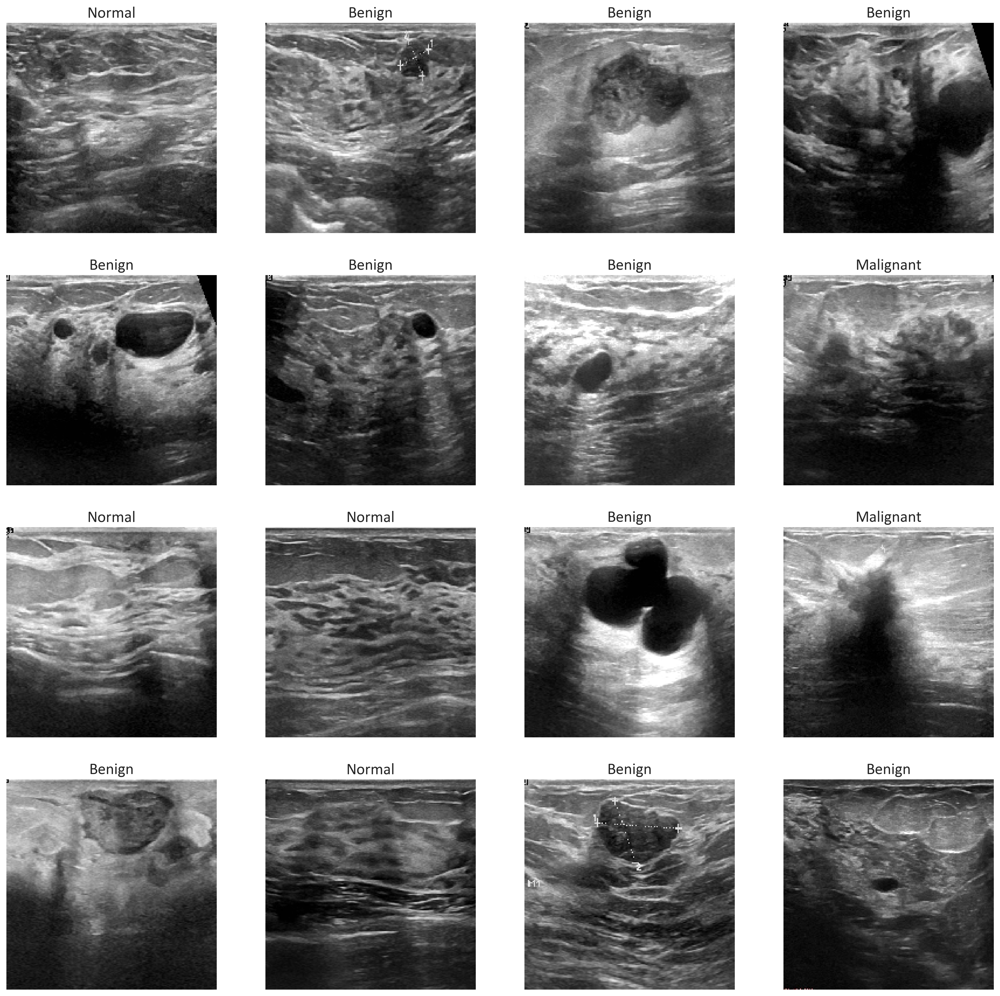

In [33]:
breast_cancer_training_data_categories = np.array(breast_cancer_training_data.class_names)
breast_cancer_training_data_categories = np.array(breast_cancer_training_data.class_names)
breast_cancer_generated_image_data = keras.preprocessing.image.ImageDataGenerator(rescale = 1./255)
breast_cancer_generated_image_data_for_training = breast_cancer_generated_image_data.flow_from_directory(breast_cancer_data,  target_size = (180, 180),  class_mode = "categorical",  shuffle = True,  batch_size = 16)
breast_cancer_images, breast_cancer_labels = next(iter(breast_cancer_generated_image_data_for_training))
def breast_cancer_images_function(breast_cancer_images, breast_cancer_labels):
    plt.figure(figsize = (20, 20))
    for n in range(16):
        ax = plt.subplot(4, 4, n+1)
        plt.imshow(breast_cancer_images[n])
        plt.title(breast_cancer_training_data_categories[breast_cancer_labels[n]==1][0].title())
        plt.axis("off")
breast_cancer_images_function(breast_cancer_images, breast_cancer_labels)


In [34]:
breast_cancer_experimental_tuning = tf.data.experimental.AUTOTUNE
breast_cancer_training_data = breast_cancer_training_data.cache().shuffle(1000).prefetch(buffer_size = breast_cancer_experimental_tuning)
breast_cancer_validation_data = breast_cancer_validation_data.cache().prefetch(buffer_size = breast_cancer_experimental_tuning)


In [35]:
breast_cancer_convolutional_net_model = Sequential([
    layers.experimental.preprocessing.Rescaling(1./255, input_shape = (180, 180, 3)),
    layers.Conv2D(16, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Conv2D(32, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Conv2D(64, 3, padding = "same", activation = "relu"),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers.Dense(128, activation = "relu"),
    layers.Dense(9, activation='softmax')])
breast_cancer_convolutional_net_model.compile(optimizer = "adam", loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True), metrics = ["accuracy"])
breast_cancer_convolutional_net_model_history = breast_cancer_convolutional_net_model.fit(breast_cancer_training_data, validation_data = breast_cancer_validation_data, epochs = 64)
breast_cancer_convolutional_net_model_history


Epoch 1/64
39/39 [==============================] - 20s 521ms/step - loss: 1.8341 - accuracy: 0.5401 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 2/64
39/39 [==============================] - 18s 470ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 3/64
39/39 [==============================] - 20s 504ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 4/64
39/39 [==============================] - 23s 595ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 5/64
39/39 [==============================] - 18s 451ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 6/64
39/39 [==============================] - 19s 479ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 7/64
39/39 [==============================] - 20s 522ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090

Epoch 58/64
39/39 [==============================] - 16s 413ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 59/64
39/39 [==============================] - 16s 410ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 60/64
39/39 [==============================] - 16s 418ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 61/64
39/39 [==============================] - 22s 563ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 62/64
39/39 [==============================] - 16s 407ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 63/64
39/39 [==============================] - 16s 413ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy: 0.6090
Epoch 64/64
39/39 [==============================] - 16s 409ms/step - loss: 1.8239 - accuracy: 0.5481 - val_loss: 1.7630 - val_accuracy:

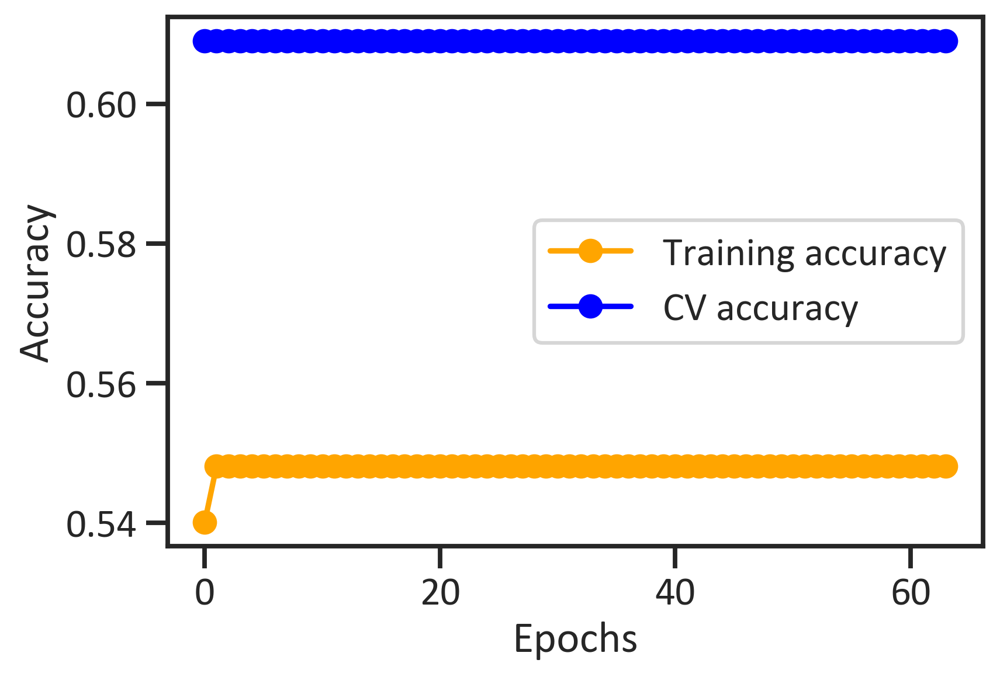

In [36]:
plt.plot(breast_cancer_convolutional_net_model_history.history["accuracy"],
         color = "orange",
         marker = "o",
         label = "Training accuracy")
plt.plot(breast_cancer_convolutional_net_model_history.history["val_accuracy"],
         color = "blue",
         marker = "o",
         label = "CV accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(loc = "best")
plt.show()


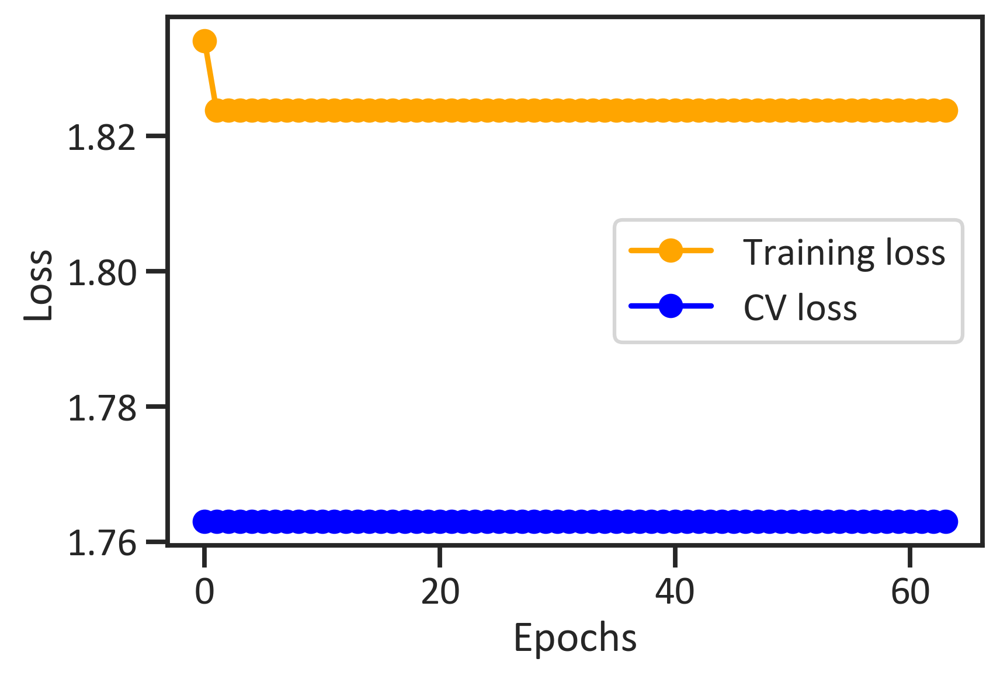

In [37]:
plt.plot(breast_cancer_convolutional_net_model_history.history["loss"],
         color = "orange",
         marker = "o",
         label = "Training loss")
plt.plot(breast_cancer_convolutional_net_model_history.history["val_loss"],
         color = "blue",
         marker = "o",
         label = "CV loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend(loc = "best")
plt.show()
